In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/My Drive/Colab Notebooks/dataset

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/My Drive/Colab Notebooks/dataset


In [ ]:
!unzip archive.zip

Streaming output truncated to the last 5000 lines.
  inflating: images/5499.jpg         
  inflating: images/55.jpg           
  inflating: images/550.jpg          
  inflating: images/5500.jpg         
  inflating: images/5501.jpg         
  inflating: images/5502.jpg         
  inflating: images/5503.jpg         
  inflating: images/5504.jpg         
  inflating: images/5505.jpg         
  inflating: images/5506.jpg         
  inflating: images/5507.jpg         
  inflating: images/5508.jpg         
  inflating: images/5509.jpg         
  inflating: images/551.jpg          
  inflating: images/5510.jpg         
  inflating: images/5511.jpg         
  inflating: images/5512.jpg         
  inflating: images/5513.jpg         
  inflating: images/5514.jpg         
  inflating: images/5515.jpg         
  inflating: images/5516.jpg         
  inflating: images/5517.jpg         
  inflating: images/5518.jpg         
  inflating: images/5519.jpg         
  inflating: images/552.jpg          

# Anime Face Generation
In the final project, you'll learn to define and train a GAN on a dataset of anime faces. The goal is to obtain a generator network to generate images of anime faces that look very cute and cartoon!

The final project includes several tasks, from loading data and training a GAN. At the end of the notebook, you will be able to visualize the results of the trained generator to understand its performance; the samples you generate should look like fairly anime faces with a small amount of noise.

**In this project, we encourage students to think about how to improve the performance of GAN and the stability of training. Students can write the experimental results and analysis into the report. This part will be used as a bonus item.**



## Download the data
You can use this link [Anime Face dataset](https://www.kaggle.com/lunarwhite/anime-face-dataset-ntumlds) to download dataset for training your adversarial networks.

This is an dataset consisting of 36.7k high-quality anime faces. We suggest that you utilize a GPU for training.

In [45]:
#import necessary libraries
import torch, torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch import nn, optim
from torchvision.utils import make_grid
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from PIL import Image
%matplotlib inline
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.axis("off")
    ax.title.set_text("Training Images")
    ax.imshow(np.transpose(make_grid(images.to(device)[:nmax], padding=2, normalize=True).cpu(),(1,2,0)))
#TODO: define your own dataset address"
root = './images/'

## Pre-process and Load the Data
Based on the previous knowledge, students are required to complete the code for preprocessing and data loading. 
### For preprocessing 
we recommend students to use `transforms` in `torchvision`. Students are required to fill in at least two items: `Resize` and `CenterCrop`. Students can also try other **data augumentation methods** and display the results in the final report as a **bonus item**.
### Load the Data
In this part, you need define your own `Dataset` to load training images. For GAN, you don't need to load label data. Thus, defining the Dataset is easier than previous assignments.

In [46]:
#TODO: Create your own Preprocessing methods
#The batch_size is defined by yourself based on the memory of GPU or CPU.
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
transform = transforms.Compose([transforms.Resize(64),
                                transforms.CenterCrop(64),
                                transforms.ToTensor(),
                                transforms.Normalize(*stats)])
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]
#TODO: Complete the loading data including Dataset and Dataloader.
class AnimeData(Dataset):
    """
    Wrap the data into a Dataset class, and then pass it to the DataLoader
    :__init__: Initialization data
    :__getitem__: support the indexing such that dataset[i] can be used to get ith sample
    :__len__: return the size of the dataset.
    """
    def __init__(self, root, transform=None):
      # Read the csv file
      self.frame = os.listdir(root)
      self.transform = transform
      self.root_path = root
        
    def __len__(self):
      return len(self.frame)
    
    def __getitem__(self, index):
        image_name = self.frame[index]
        image = Image.open(os.path.join(self.root_path,image_name))
        if self.transform:
            image = self.transform(image)
        return image
        
#TODO: Complete the trainloader 
trainset = AnimeData(root, transform=transform)
trainloader = DataLoader(trainset, batch_size, shuffle=True, num_workers=2)

## Visualize the input image
Note that these are color images with 3 color channels (RGB) each.

total number of training set: 36740


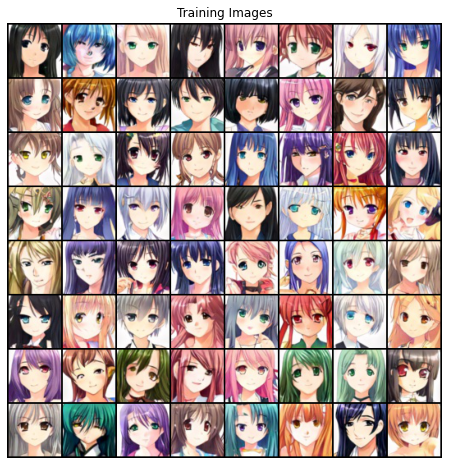

In [47]:
batch = next(iter(trainloader))
show_images(batch)
#plt.show()

# Print the number of total images in the training set
print('total number of training set: {}'.format(len(trainset)))

## Check your device and move data to device
In this part, students can check whether the computer's GPU is available and move the data to the GPU (or CPU). We strongly recommend that students use GPU to speed up the program. 

`torch.cuda.is_available` can help us to check whether GPU is available.

In [48]:
if torch.cuda.is_available():
    device=torch.device('cuda')
else:
    device=torch.device('cpu')

## Define a GAN
A GAN consists of two adversarial networks, a discriminator and a generator.
### Discriminator
Your first task will be to define the discriminator. This is a convolutional classifier like you've built before, only without any maxpooling layers. 
#### Exercise: Complete the Discriminator class
* The inputs to the discriminator are 3x64x64 tensor images
* The output should be a single value that will indicate whether a given image is real or fake

An example of our discriminant model is as follows, and students can also define it by themselves, including adjusting the model structure and activation function. We recommend that students use `nn.Sequential` to define the model, which is more simple and intuitive.
<img src='./img/d.png' width=80% />

**Students can build models based on examples, but we suggest you try different models (including model structure and activation function). This will be regared as a bonus.**

In [49]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [50]:
#TODO: Create your Discriminator model
class Discriminator(nn.Module):
    def __init__(self,inchannels):
        super(Discriminator,self).__init__()
        """
        Initialize the Discriminator Module
        :param inchannels: The depth of the first convolutional layer
        """
        self.network = nn.Sequential(
            nn.Conv2d(in_channels=inchannels, out_channels=64, kernel_size=4, stride=2, padding=1,bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
      
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1,bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1,bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1,bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0,bias=False),
            
            nn.Sigmoid()
        )
        
    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network     
        :return: Discriminator logits; the output of the neural network
        """
        return self.network(x)
        
D=Discriminator(3).to(device)
D.apply(weights_init)

Discriminator(
  (network): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_siz

## Generator

The generator should upsample an input and generate a *new* image of the same size as our training data `3x64x64`. This should be mostly transpose convolutional layers `nn.ConvTranspose2d` with normalization applied to the outputs.

#### Exercise: Complete the Generator model
* The inputs to the generator are vectors of some length `latent_size`
* The output should be a image of shape `3x64x64`

The example of Generator is as follows. 
<img src='./img/g.png' width=80% />

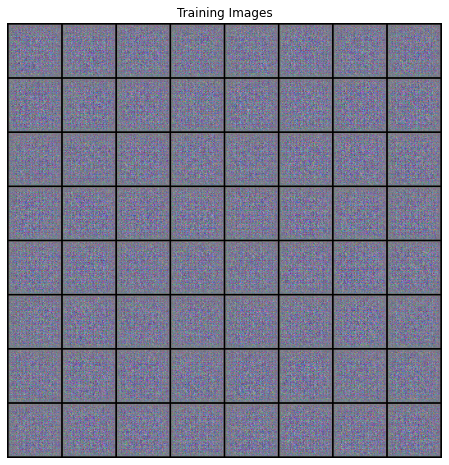

In [51]:
#TODO: Create your Generator model
latent_size = 512
class Generator(nn.Module):
    def __init__(self,latent_size):
        super(Generator,self).__init__()
        """
        Initialize the Generator Module
        :param latent_size: The length of the input latent vector
        """
        self.network = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size,out_channels=512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=512,out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=256,out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=128,out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=64,out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
            )

    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network     
        :return: A 3x64x64 Tensor image as output
        """
        return self.network(x)
        
G=Generator(latent_size).to(device)
G.apply(weights_init)
# random latent tensors
noise = torch.randn(batch_size, latent_size, 1, 1, device=device)
#TODO: use generator model to generate fake image 
fake_images = G.forward(noise)
#TODO: visualize the fake images by function show_images
show_images(fake_images)

---
## Discriminator and Generator Losses

Now we need to calculate the losses for both types of adversarial networks.

### Discriminator Losses

> * For the discriminator, the total loss is the sum of the losses for real and fake images, `d_loss = d_real_loss + d_fake_loss`. 
* Remember that we want the discriminator to output 1 for real images and 0 for fake images, so we need to set up the losses to reflect that.


### Generator Loss

The generator loss will look similar only with flipped labels. The generator's goal is to get the discriminator to *think* its generated images are *real*.

#### Exercise: Complete real and fake loss functions

**You may choose to use either cross entropy or a least squares error loss to complete the following `real_loss` and `fake_loss` functions. We also encourage students to use the loss function in other related papers as a bonus item. If you use it, please include a citation in the report**

In [52]:
#TODO：Complete the loss function for training GAN
bce_loss = nn.BCELoss()
def Real_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being real.
       param, D_out: discriminator logits
       return: real loss
    '''
    loss = bce_loss(preds,targets)
    return loss
def Fake_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being fake.
       param, D_out: discriminator logits
       return: fake loss
    '''
    loss = bce_loss(preds,targets)
    return loss

## Optimizers

#### Exercise: Define optimizers for your Discriminator (D) and Generator (G)

Define optimizers for your models with appropriate hyperparameters.

In [53]:
# Create optimizers for the discriminator D and generator G
#Define your learning rate
lr=0.0002
opt_d = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_g = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))

### Save the generated images
This code can help you save images generated from Generator G

In [54]:
##Define your save path.
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)
def save_samples(index, latent_tensors, generator, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        plt.show()
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

## Training GAN to generate anime faces
Training will involve alternating between training the discriminator and the generator. You'll use your functions `real_loss` and `fake_loss` to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function


#### Saving Samples

You've been given some code to save some generated "fake" samples.

#### Exercise: Complete the training function

Keep in mind that, if you've moved your models to GPU, you'll also have to move any model inputs to GPU.

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [1/40], loss_g: 35.5733, loss_d: 0.0000, real_score: 1.0000, fake_score: 0.0000
Saving generated-images-0001.png


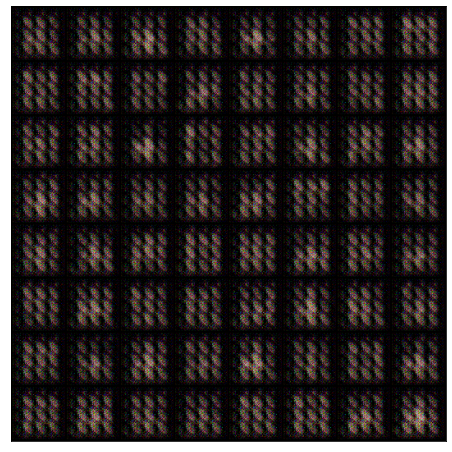

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [2/40], loss_g: 4.1660, loss_d: 0.5628, real_score: 0.8378, fake_score: 0.2722
Saving generated-images-0002.png


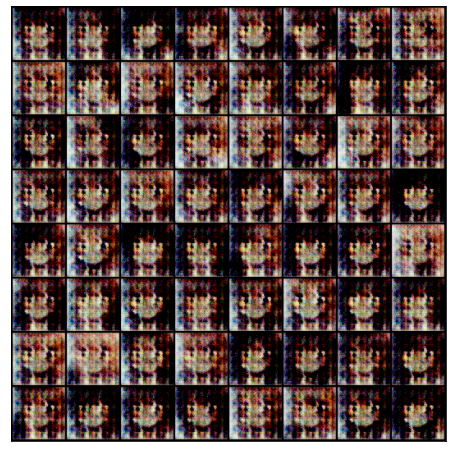

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [3/40], loss_g: 6.1893, loss_d: 3.4181, real_score: 0.0350, fake_score: 0.0002
Saving generated-images-0003.png


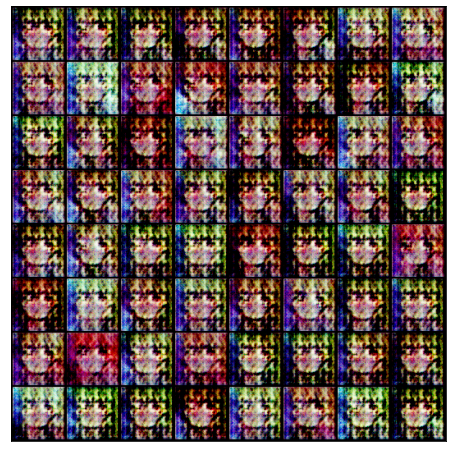

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [4/40], loss_g: 1.1373, loss_d: 0.9365, real_score: 0.6743, fake_score: 0.1641
Saving generated-images-0004.png


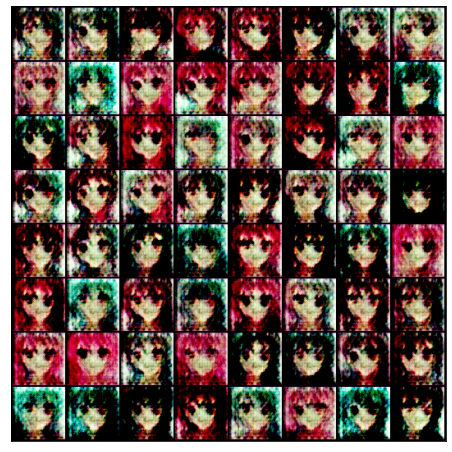

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [5/40], loss_g: 3.0241, loss_d: 1.3079, real_score: 0.4387, fake_score: 0.0040
Saving generated-images-0005.png


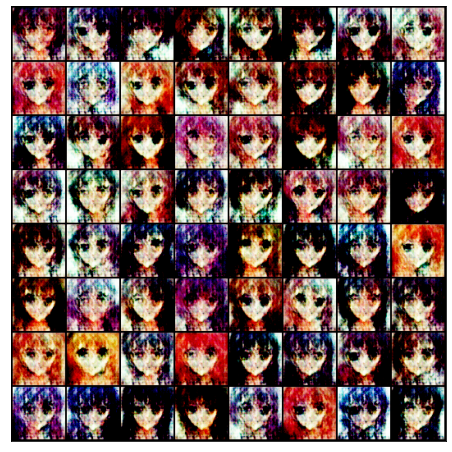

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [6/40], loss_g: 0.8758, loss_d: 1.0119, real_score: 0.5335, fake_score: 0.1132
Saving generated-images-0006.png


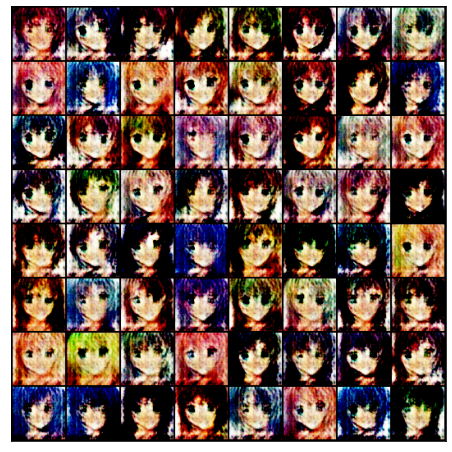

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [7/40], loss_g: 5.8595, loss_d: 0.1369, real_score: 0.9551, fake_score: 0.0842
Saving generated-images-0007.png


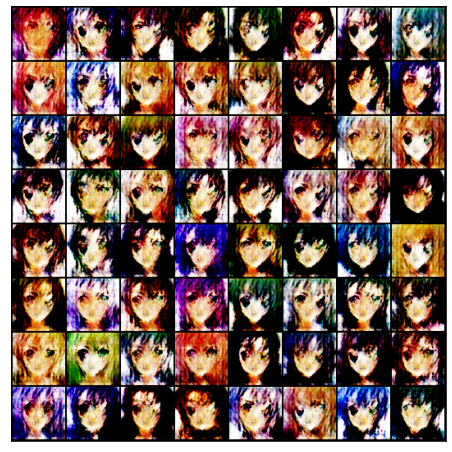

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [8/40], loss_g: 0.5580, loss_d: 1.7704, real_score: 0.2527, fake_score: 0.0172
Saving generated-images-0008.png


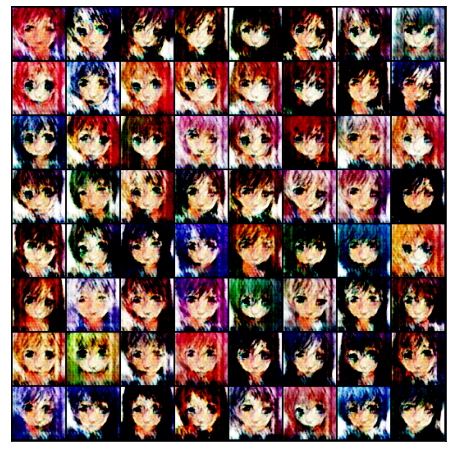

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [9/40], loss_g: 3.5076, loss_d: 0.3970, real_score: 0.8419, fake_score: 0.1767
Saving generated-images-0009.png


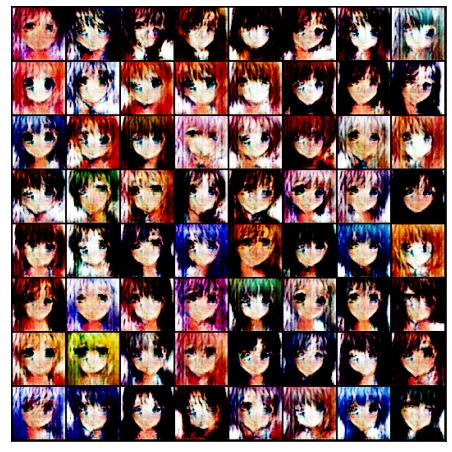

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [10/40], loss_g: 2.9555, loss_d: 2.1785, real_score: 0.3371, fake_score: 0.0076
Saving generated-images-0010.png


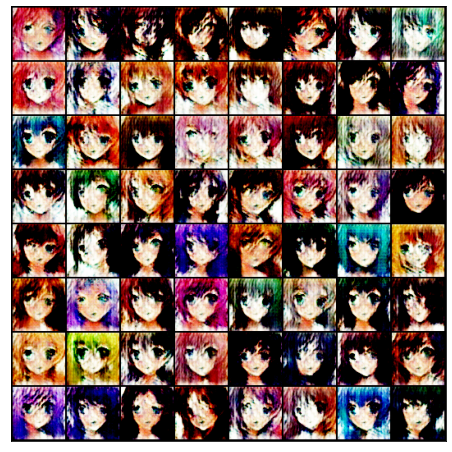

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [11/40], loss_g: 6.0057, loss_d: 0.2503, real_score: 0.9903, fake_score: 0.2006
Saving generated-images-0011.png


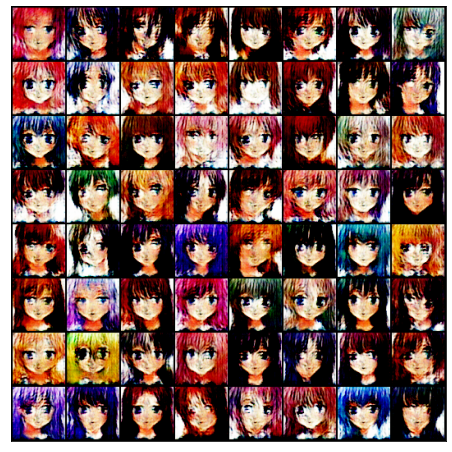

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [12/40], loss_g: 0.6095, loss_d: 0.4028, real_score: 0.7481, fake_score: 0.0777
Saving generated-images-0012.png


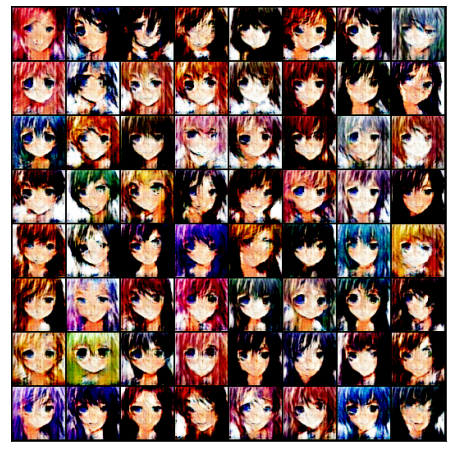

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [13/40], loss_g: 4.5183, loss_d: 0.1630, real_score: 0.9158, fake_score: 0.0679
Saving generated-images-0013.png


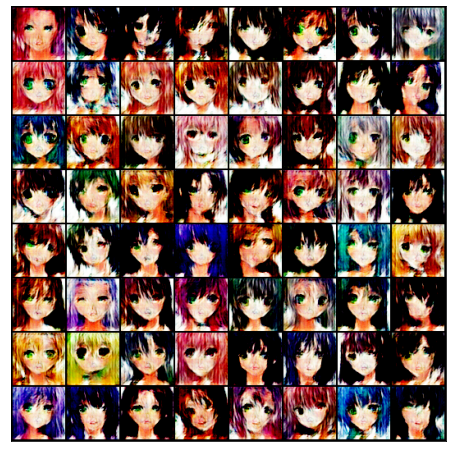

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [14/40], loss_g: 5.7411, loss_d: 0.4813, real_score: 0.8508, fake_score: 0.2616
Saving generated-images-0014.png


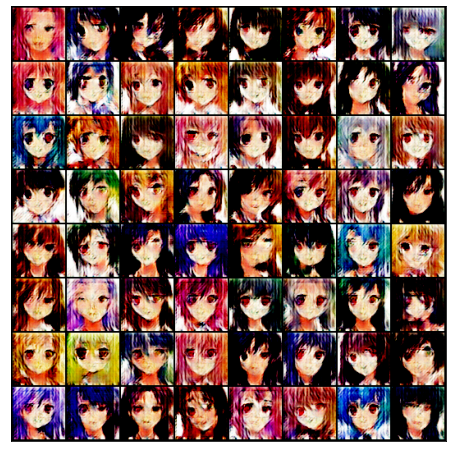

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [15/40], loss_g: 2.4612, loss_d: 0.8001, real_score: 0.5672, fake_score: 0.0586
Saving generated-images-0015.png


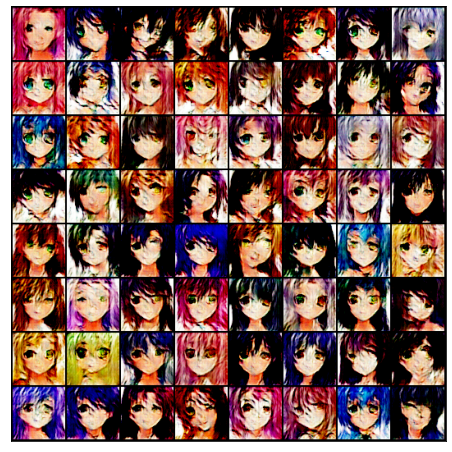

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [16/40], loss_g: 6.5142, loss_d: 0.3825, real_score: 0.9334, fake_score: 0.2635
Saving generated-images-0016.png


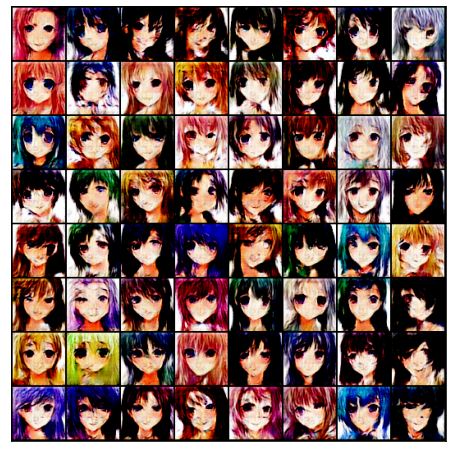

  0%|          | 0/288 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f3510540040>
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py", line 1466, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py", line 1449, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.8/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f3510540040>
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py", line 1466, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py", line 1449, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/pytho

Epoch [17/40], loss_g: 3.3164, loss_d: 0.3477, real_score: 0.8041, fake_score: 0.1123
Saving generated-images-0017.png


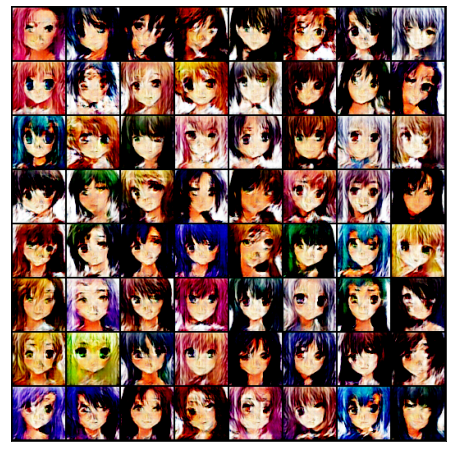

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [18/40], loss_g: 2.6344, loss_d: 0.2466, real_score: 0.8397, fake_score: 0.0581
Saving generated-images-0018.png


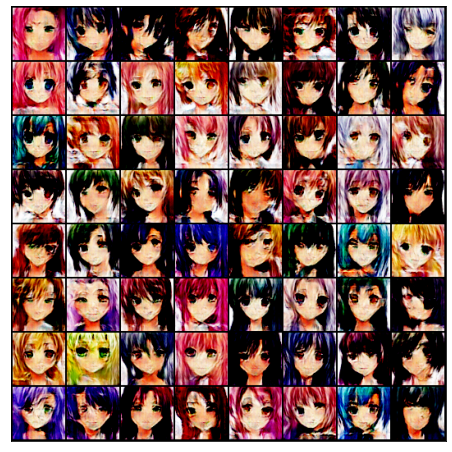

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [19/40], loss_g: 2.0274, loss_d: 0.2918, real_score: 0.7633, fake_score: 0.0127
Saving generated-images-0019.png


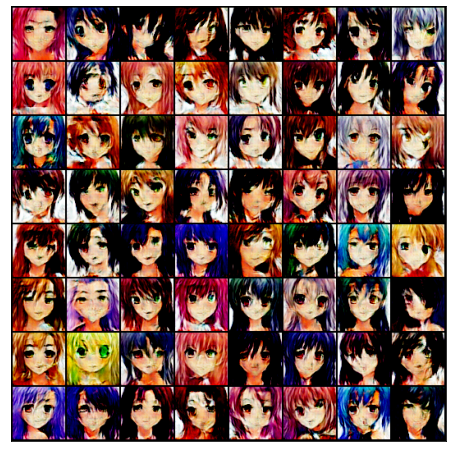

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [20/40], loss_g: 8.1401, loss_d: 0.5168, real_score: 0.9936, fake_score: 0.3474
Saving generated-images-0020.png


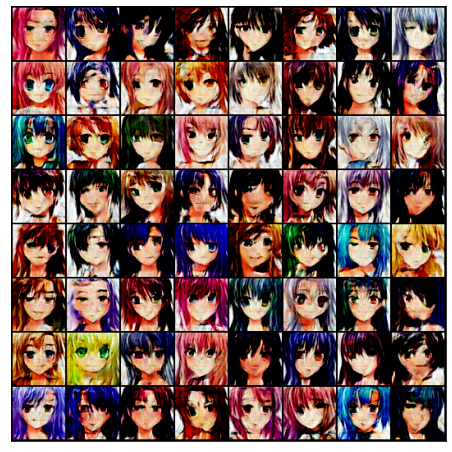

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [21/40], loss_g: 5.4400, loss_d: 0.2352, real_score: 0.8351, fake_score: 0.0462
Saving generated-images-0021.png


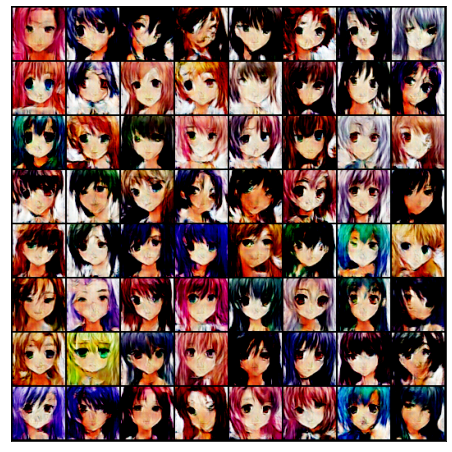

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [22/40], loss_g: 3.1022, loss_d: 0.6194, real_score: 0.8098, fake_score: 0.2109
Saving generated-images-0022.png


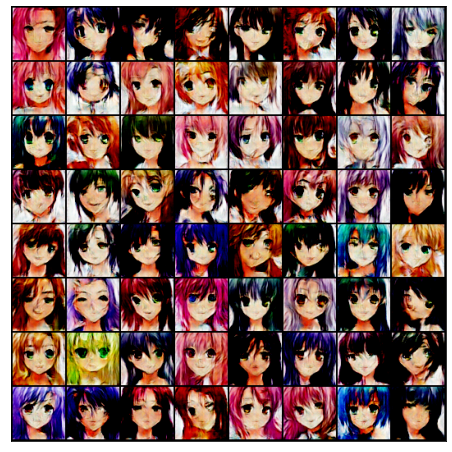

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [23/40], loss_g: 5.0236, loss_d: 0.2497, real_score: 0.8138, fake_score: 0.0030
Saving generated-images-0023.png


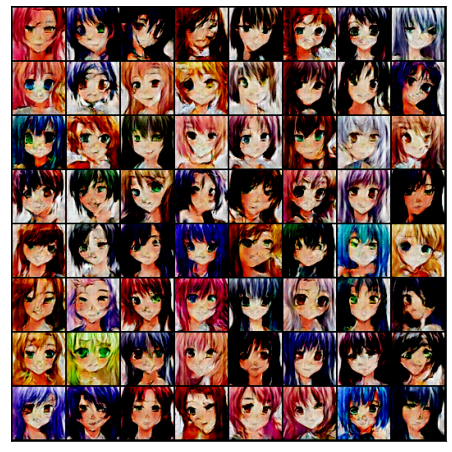

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [24/40], loss_g: 0.0652, loss_d: 1.5400, real_score: 0.2897, fake_score: 0.1384
Saving generated-images-0024.png


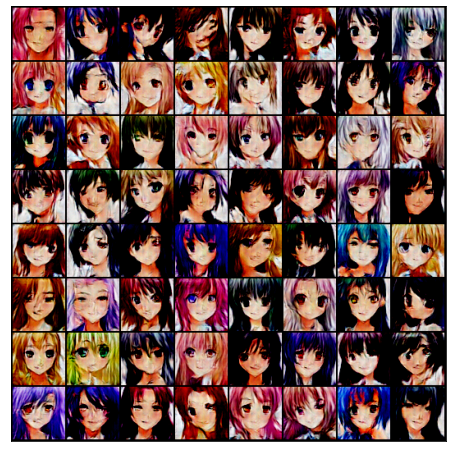

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [25/40], loss_g: 4.0533, loss_d: 0.6656, real_score: 0.8005, fake_score: 0.2652
Saving generated-images-0025.png


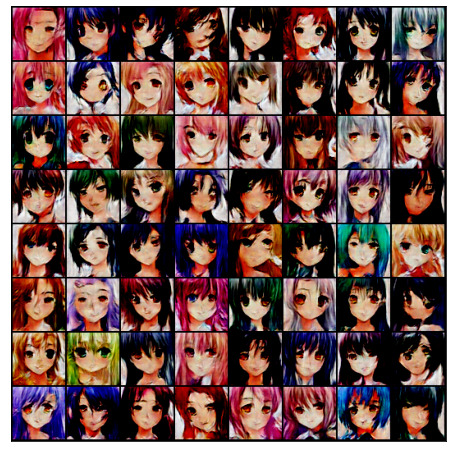

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [26/40], loss_g: 1.7703, loss_d: 0.2038, real_score: 0.8777, fake_score: 0.0488
Saving generated-images-0026.png


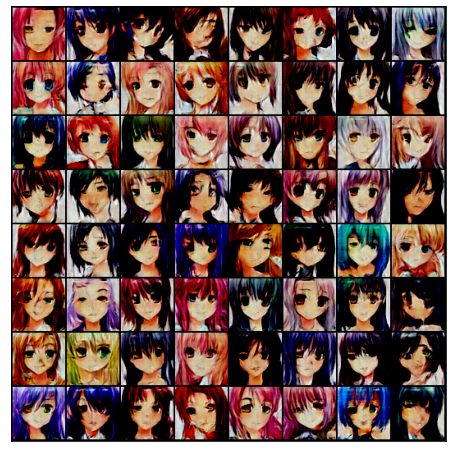

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [27/40], loss_g: 8.5548, loss_d: 2.0604, real_score: 0.9962, fake_score: 0.7076
Saving generated-images-0027.png


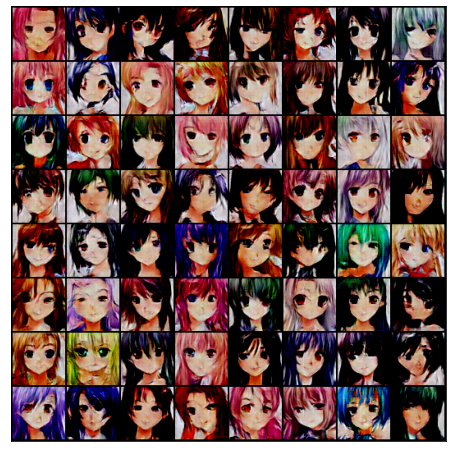

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [28/40], loss_g: 9.8501, loss_d: 0.9081, real_score: 0.9465, fake_score: 0.5005
Saving generated-images-0028.png


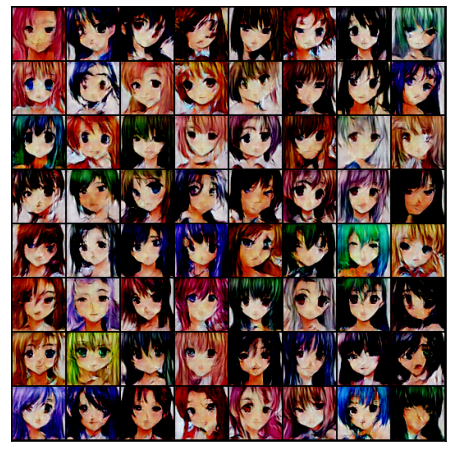

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [29/40], loss_g: 3.4955, loss_d: 0.1673, real_score: 0.9167, fake_score: 0.0690
Saving generated-images-0029.png


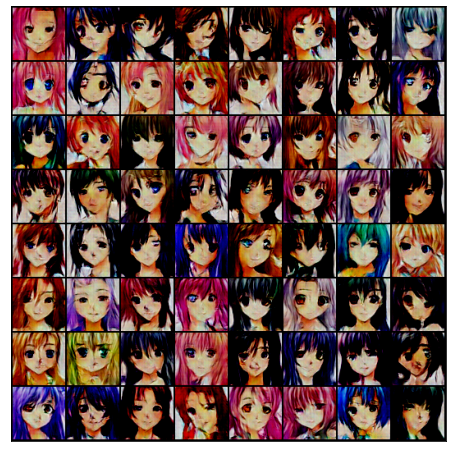

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [30/40], loss_g: 1.2598, loss_d: 0.3055, real_score: 0.9048, fake_score: 0.1706
Saving generated-images-0030.png


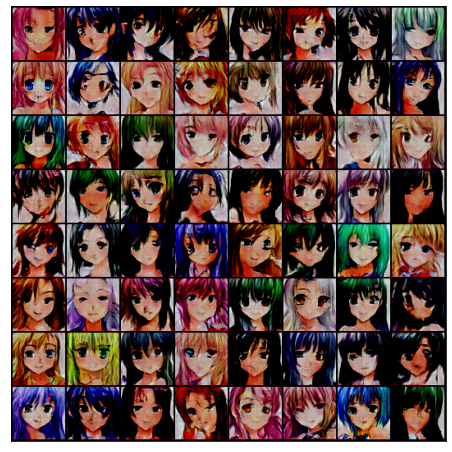

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [31/40], loss_g: 0.1645, loss_d: 0.9353, real_score: 0.4570, fake_score: 0.0170
Saving generated-images-0031.png


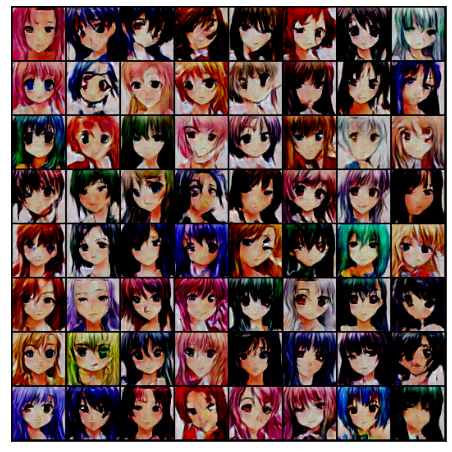

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [32/40], loss_g: 1.1673, loss_d: 0.2745, real_score: 0.7889, fake_score: 0.0148
Saving generated-images-0032.png


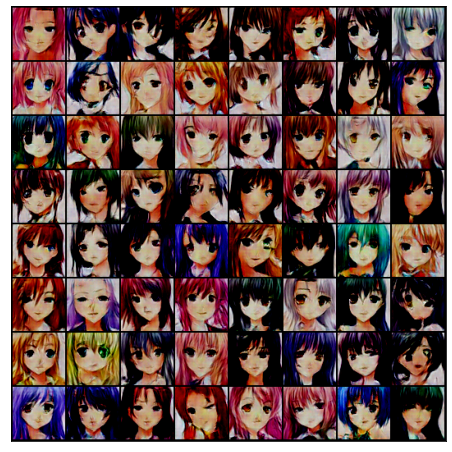

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [33/40], loss_g: 0.0651, loss_d: 1.0837, real_score: 0.3815, fake_score: 0.0277
Saving generated-images-0033.png


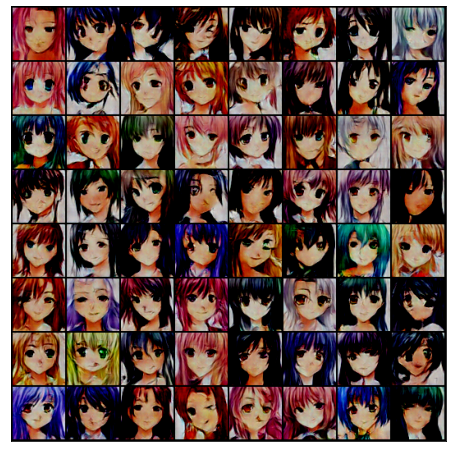

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [34/40], loss_g: 3.0204, loss_d: 0.8614, real_score: 0.6015, fake_score: 0.2386
Saving generated-images-0034.png


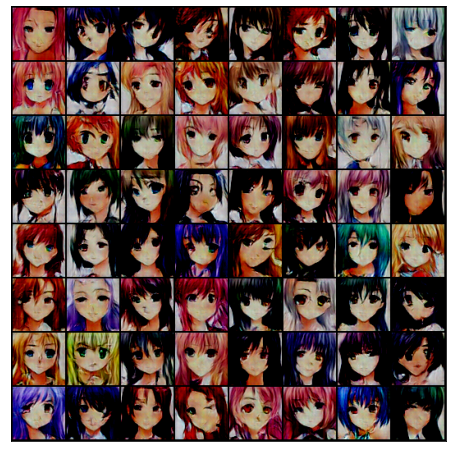

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [35/40], loss_g: 2.2667, loss_d: 1.3514, real_score: 0.2836, fake_score: 0.0054
Saving generated-images-0035.png


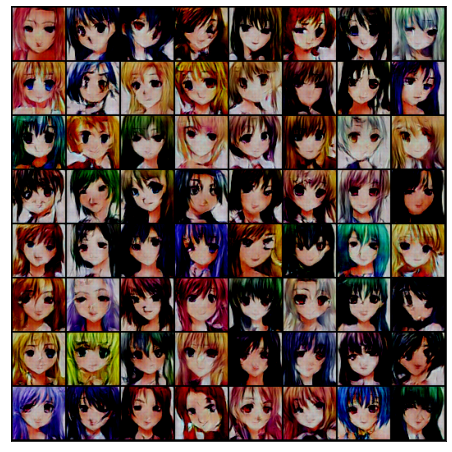

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [36/40], loss_g: 6.2430, loss_d: 0.1650, real_score: 0.9713, fake_score: 0.1146
Saving generated-images-0036.png


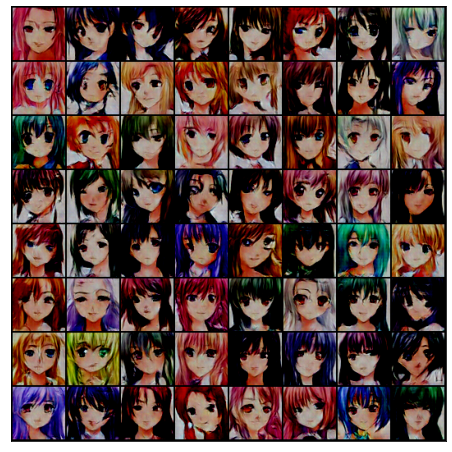

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [37/40], loss_g: 0.0294, loss_d: 2.6028, real_score: 0.1184, fake_score: 0.0829
Saving generated-images-0037.png


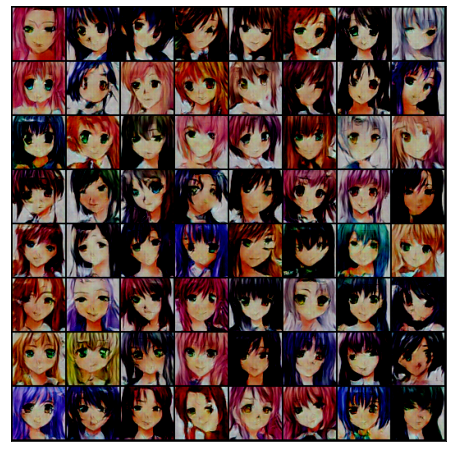

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [38/40], loss_g: 1.1196, loss_d: 1.2054, real_score: 0.6354, fake_score: 0.2938
Saving generated-images-0038.png


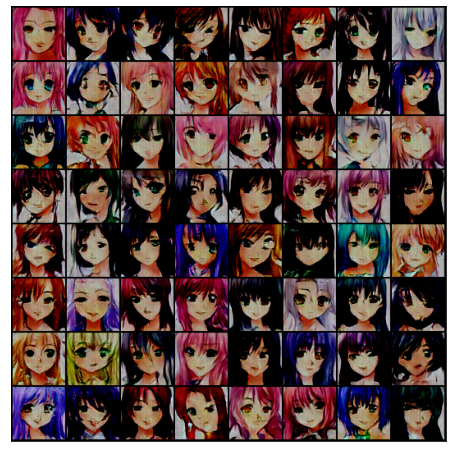

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [39/40], loss_g: 4.8329, loss_d: 0.7181, real_score: 0.9644, fake_score: 0.4510
Saving generated-images-0039.png


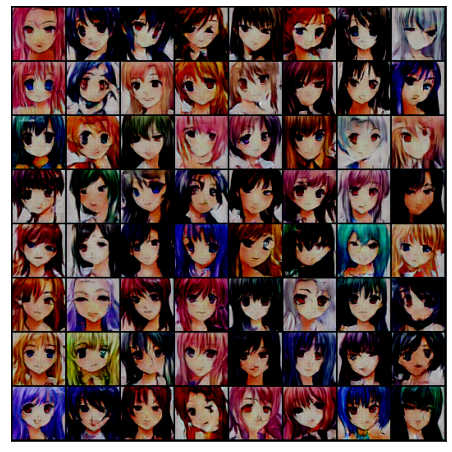

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [40/40], loss_g: 3.4254, loss_d: 0.2363, real_score: 0.9103, fake_score: 0.1248
Saving generated-images-0040.png


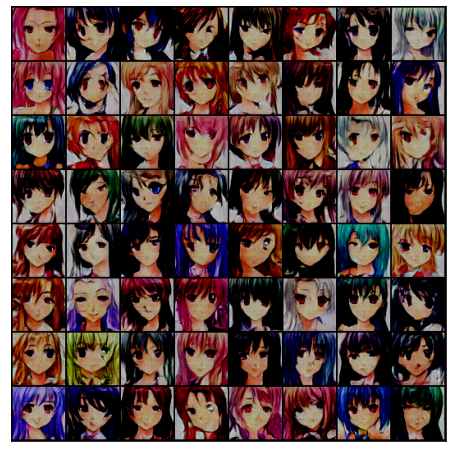

In [55]:
#TODO: Complete the training function
losses_g = []
losses_d = []
real_scores = []
fake_scores = []
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(trainloader):
            real_images=real_images.to(device)
            # -----------------------------------------------
            #         YOUR CODE HERE: TRAIN THE NETWORKS
            # -----------------------------------------------
            # 1. Train the discriminator on real and fake images
            # Pass real images through discriminator
            D.zero_grad()

            output = D(real_images).view(-1)
            labels = torch.ones( (real_images.size(0),), dtype=torch.float, device=device)
            real_loss = bce_loss(output, labels)
            real_loss.backward()
            real_score = output.mean().item()
            # Generate fake images
            
            # Pass fake images through discriminator
            noise = torch.randn(real_images.size(0), latent_size, 1, 1, device=device)
            fake_images = G(noise)
            output = D(fake_images.detach()).view(-1)
            labels = torch.zeros( (real_images.size(0),), dtype=torch.float, device=device)
            fake_loss = bce_loss(output, labels)
            fake_loss.backward()
            fake_score = output.mean().item()

            d_optimizer.step()
            
            # Update discriminator weights
            loss_d = real_loss + fake_loss
            
            ## 2. Train the generator with an adversarial loss
            # Generate fake images
            G.zero_grad()
            noise = torch.randn(real_images.size(0), latent_size, 1, 1, device=device)
            fake_images = G(noise)

            # Try to fool the discriminator
            output = D(fake_images).view(-1)
           
            # The label is set to 1(real-like) to fool the discriminator
            labels = torch.ones( (real_images.size(0),), dtype=torch.float, device=device)
            
            loss_g = bce_loss(output, labels)
            # Update generator weights
            loss_g.backward()
            g_optimizer.step()
              
        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        save_samples(epoch+start_idx, fixed_latent,G, show=True)
            
        state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
        state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
        if not os.path.isdir('checkpoint'):
            os.mkdir('checkpoint') 
        torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(D,G,opt_d,opt_g,epochs=40)

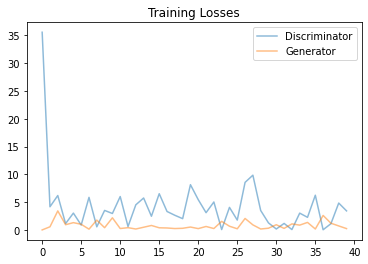

In [56]:
##Visualize your loss curve of D and G
fig, ax = plt.subplots()
plt.plot(losses_g, label='Discriminator', alpha=0.5)
plt.plot(losses_d, label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question1: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result

Answer: In the first 10 epochs the changes that the generator model made were quite considerable. Afterwards, in the remaining iterations it cannot optimize the faces significantly. Although the faces are quite in good shape in the last epocs, the details such as location of cornea of eyes have a lot of issues. For instance, the face[0,2] (row, column) is perfect in epoch 40. But the face[3,7] got blurry in epoch 40, while it was perfect in epoch 29. As a result, we can not be sure that increasing of epochs converges to a better result.

I have not tested a larger model. However, I can predict that this could lead to finding better patterns in data feature space.

### Question2: How does the training loss of the generator and the discriminator change during your training?

Answer: At the early stage (first three epochs) Discriminator loss has decreased substantially. As the time goes by, loss gets smaller. But there are still fluctuations between epoch 25 and 30, 33, and 37.

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "final_project_StudentNumber_StudentName.ipynb". Include the generated images in your submission.